Statistical ap.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import pandas as pd

# load the dataset
df = pd.read_csv('/content/drive/MyDrive/DM&KD/Market_Basket_Optimisation.csv')

#Check number of rows and columns in the dataset
print("The dataset has %d rows and %d columns." % df.shape)

The dataset has 34562 rows and 12 columns.


In [ ]:
df[pd.isnull(df).any(axis=1)]

,Unnamed: 0,inter_api_access_duration(sec),api_access_uniqueness,sequence_length(count),vsession_duration(min),ip_type,behavior,behavior_type,num_sessions,num_users,num_unique_apis,source
1117,1117,NaN,NaN,0.0,3,aws_datacenter,outlier,outlier,4.0,1.0,0.0,E
1360,1360,NaN,NaN,0.0,3,aws_datacenter,outlier,outlier,2.0,1.0,0.0,E
1776,1776,NaN,NaN,0.0,3,aws_datacenter,outlier,outlier,4.0,1.0,0.0,E
10718,10718,NaN,NaN,0.0,3,default,outlier,outlier,2.0,1.0,0.0,E
12348,12348,NaN,NaN,0.0,3,aws_datacenter,outlier,outlier,2.0,1.0,0.0,E


In [ ]:
df = df.fillna(df.mean())

<ipython-input-5-04e87d67d337>:1: FutureWarning: The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  df = df.fillna(df.mean())


In [ ]:
missing_values = df.isin([-1]).any(axis=1)

In [ ]:
df[missing_values]

,Unnamed: 0,inter_api_access_duration(sec),api_access_uniqueness,sequence_length(count),vsession_duration(min),ip_type,behavior,behavior_type,num_sessions,num_users,num_unique_apis,source


In [ ]:
df.describe()

,Unnamed: 0,inter_api_access_duration(sec),api_access_uniqueness,sequence_length(count),vsession_duration(min),num_sessions,num_users,num_unique_apis
count,34562.000000,34562.000000,34562.000000,34562.000000,3.456200e+04,34562.000000,34562.000000,34562.000000
mean,17280.500000,20.503248,0.444269,65.281684,2.949855e+04,9.874689,3.604913,15.477548
std,9977.334338,77.830858,0.302196,152.026311,7.973480e+04,64.937144,10.501039,15.359834
min,0.000000,0.000000,0.000714,0.000000,0.000000e+00,1.000000,1.000000,0.000000
25%,8640.250000,0.372443,0.191011,6.666667,5.280000e+02,1.000000,1.000000,5.000000
50%,17280.500000,2.185428,0.384615,15.000000,5.901000e+03,1.000000,1.000000,10.000000
75%,25920.750000,9.448180,0.666667,58.000000,2.493900e+04,3.000000,2.000000,21.000000
max,34561.000000,2333.627333,1.000000,2800.000000,2.787530e+06,1462.000000,219.000000,178.000000


In [ ]:
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
            },
          });
        </script>
        '''))

In [ ]:
import plotly
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.offline import init_notebook_mode

configure_plotly_browser_state()

init_notebook_mode(connected=False)# to show plots in notebook

from plotly.offline import plot, iplot

# do not show any warnings
import warnings
warnings.filterwarnings('ignore')


colors = plotly.colors.DEFAULT_PLOTLY_COLORS


def create_box_trace(col, visible=False):
    return go.Box(
        y=df[col],
        name=col,
        marker = dict(color = colors[0]),
        visible=visible,
    )

features_not_for_hist = ["unnamed","ip_type", "ip_type", "behavior_type"]
features_for_hist = [x for x in df.columns if x not in features_not_for_hist]
# remove features with too less distinct values (e.g. binary features), because boxplot does not make any sense for them
features_for_box = [col for col in features_for_hist if len(df[col].unique())>5]

active_idx = 0
box_traces = [(create_box_trace(col) if i != active_idx else create_box_trace(col, visible=True)) for i, col in enumerate(features_for_box)]

data = box_traces

n_features = len(features_for_box)
steps = []
for i in range(n_features):
    step = dict(
        method = 'restyle',
        args = ['visible', [False] * len(data)],
        label = features_for_box[i],
    )
    step['args'][1][i] = True # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active = active_idx,
    currentvalue = dict(
        prefix = "Feature: ",
        xanchor= 'center',
    ),
    pad = {"t": 50},
    steps = steps,
    len=1,
)]

layout = dict(
    sliders=sliders,
    yaxis=dict(
        title='value',
        automargin=True,
    ),
    legend=dict(
        x=0,
        y=1,
    ),
)

fig = dict(data=data, layout=layout)

iplot(fig, filename='box_slider')

Regression

<Axes: xlabel='sequence_length(count)', ylabel='num_unique_apis'>

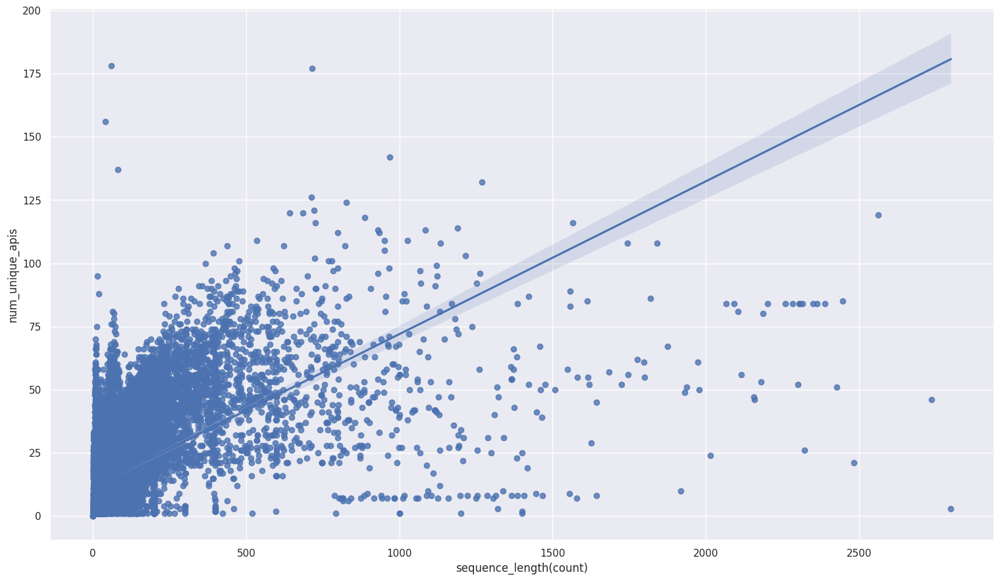

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_theme(color_codes=True)
fig, ax = plt.subplots()
fig.set_size_inches(18.5, 10.5)
sns.regplot(x="sequence_length(count)", y="num_unique_apis", data=df, ax=ax)

In [ ]:
# implementing the regression equation
def regression_equation(x, y):
    x_mean = x.mean()
    y_mean = y.mean()
    x_squared = (x**2).sum()
    xy = (x*y).sum()
    std_dev = x.std()
    var_x = std_dev ** 2
    cov_xy = (xy - len(x)*x_mean*y_mean)/(len(x)-1)
    b_1 = cov_xy/var_x
    b_0 = y_mean - b_1*x_mean
    print('Regression equation is: %.3f %.3f (x)' % (b_0, b_1))
    y_hat = b_0+b_1*x
    return y_hat


In [ ]:
pred = regression_equation(df['inter_api_access_duration(sec)'], df['api_access_uniqueness'])
print(pred)

Regression equation is: 0.437 0.000 (x)
0        0.439629
1        0.454900
2        0.446111
3        0.437289
4        0.437261
           ...   
34557    0.437229
34558    0.438010
34559    0.437354
34560    0.437354
34561    0.441285
Name: inter_api_access_duration(sec), Length: 34562, dtype: float64


In [ ]:
#plot libaries
import plotly
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.offline import init_notebook_mode

configure_plotly_browser_state()

init_notebook_mode(connected=False)# to show plots in notebook


layout = dict(
    yaxis=dict(
        title='num_unique_apis',
        automargin=True,
    ),
    xaxis=dict(
        title='Feature: vsession_duration',
        automargin=True,
    ),
)
fig = go.Figure(layout=layout)

# Add traces
fig.add_trace(go.Scatter(x=df['num_sessions'], y=df['num_unique_apis'],
                    mode='markers',
                    name='num_unique_apis'))
fig.add_trace(go.Scatter(x=df['num_sessions'], y=(59.961-2.462*df['num_sessions']),
                    mode='lines',
                    name='Regression'))


fig.show()

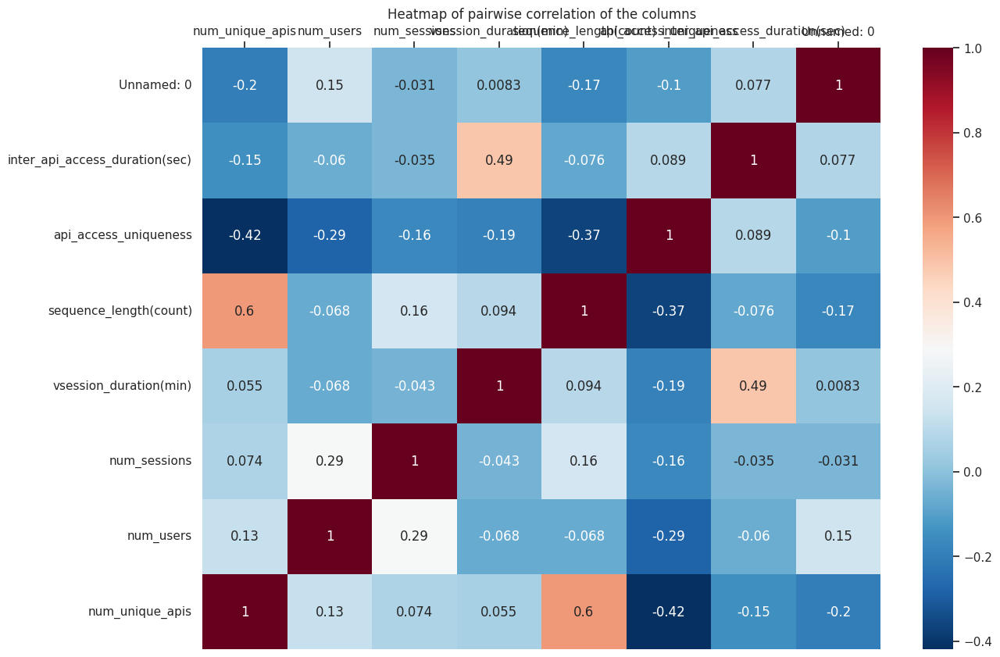

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

f, ax = plt.subplots(figsize=(14, 10))

corr = df.corr()

ax = sns.heatmap(corr, cmap = "RdBu_r", annot=True)

ax.invert_xaxis()

ax.xaxis.set_ticks_position('top')

plt.title("Heatmap of pairwise correlation of the columns")

plt.show()